# scVI data integration of stromal compartment

In [10]:
import sys 
import os
from datetime import datetime

import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import scvi
import hdf5plugin

import matplotlib.pyplot as plt
import seaborn as sns

# Add repo path to sys path (allows to access scripts and metadata from repo)
repo_path = os.path.split(os.getcwd())[0]
sys.path.insert(1, repo_path) 
sys.path.insert(2, '/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/data')

import torch
torch.cuda.is_available()


True

In [11]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [12]:
sys.path.append('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/scripts')
from scvi_wrapper2 import run_scvi

In [13]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100
import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

In [14]:
# Define plot and path dirs
plot_path = os.path.join(repo_path, 'plots')
data_path = os.path.join(repo_path, 'data')
model_path = os.path.join(repo_path, 'models')
general_data_path = '/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/data'

In [15]:
data_path

'/nfs/team205/vk8/projects/thymus_ageing_atlas/TEC_compartment/data'

## Load data

In [7]:
adata = ad.read_h5ad (f'{data_path}/objects/thyAgeing_scvi_v3_2024-11-05_tec-fb-vascSplit_v4_2layers_300epochs_2024-12-12.zarr')

In [8]:
new_obs = pd.read_csv(f'{data_path}/objects/thyAgeing_scvi_v3_2024-11-05_tec-fb-vascSplit_doubl_anno_2025-01-06.csv', index_col = 0)

/tmp/ipykernel_1859602/1568174916.py:1: DtypeWarning: Columns (5,6,7,8,9,14,15,17,20,21,34,35,36,45,46,47,48,49,50) have mixed types. Specify dtype option on import or set low_memory=False.
  new_obs = pd.read_csv(f'{data_path}/objects/thyAgeing_scvi_v3_2024-11-05_tec-fb-vascSplit_doubl_anno_2025-01-06.csv', index_col = 0)


In [9]:
adata.obs[['doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular']] = new_obs.reindex(adata.obs_names)[['doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular']].copy()

In [15]:
adata = adata[adata.obs['doublet']!='manual_doublet'].copy()
adata.shape

(254703, 35530)

## Data integration

In [16]:
# Inspect number of cells per data set: very few cells in Campinoti causing singularities during hvg selection, hence using `span = 0.5`
adata.obs.groupby('study').agg(n_cells = ('study', 'count'),
                               mean_genes = ('n_genes', 'mean'))

/tmp/ipykernel_1859602/1707141836.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby('study').agg(n_cells = ('study', 'count'),


,n_cells,mean_genes
study,,
Bautista2021,28342,1776.874427
Campinoti2020,1250,2249.389600
Heimli2024,12543,1765.417045
Li2024,2991,2060.412571
Notarangelo2024,30843,1152.815323
Park2020,36766,1399.640728
TabulaSapiens2022,10967,2321.427920
Thymus_ageing,117342,2321.706703
Yayon2024,13659,2768.245479


First round of integration using 3000 highly variable genes (ran for 38 epochs with early stopping).

In [17]:
samples2remove = adata.obs['sample'].value_counts().loc[(adata.obs['sample'].value_counts()<3)].index.tolist()
samples2remove


['Z16-THY-0-SC-1',
 'Thy7',
 'TEC_90',
 'TTA11',
 'TTA13',
 'THY_112',
 'TTA7',
 'sample3',
 'TTA8',
 'sample9',
 'sample11']

In [18]:
samples2remove = adata.obs['sample'].value_counts().loc[(adata.obs['sample'].value_counts()<3)].index.tolist()
samples2remove
adata_temp = adata.copy()
adata = adata[~adata.obs['sample'].isin(samples2remove),:].copy()
adata_temp.shape
adata.shape

['Z16-THY-0-SC-1',
 'Thy7',
 'TEC_90',
 'TTA11',
 'TTA13',
 'THY_112',
 'TTA7',
 'sample3',
 'TTA8',
 'sample9',
 'sample11']

(254703, 35530)

(254685, 35530)

In [23]:
general_mrkrs = ['PTPRC', 'CD3G', 
               'HOXA9', 
               'HES1', #DN
               'RORC', #DP
               'CCR9',
              'PDCD1', #CD8aa
              'CD8A', 'CD8B', 
              'CD4', 'CD40LG', 
              'CRTAM', 'ANXA1', #memory
             'FOXP3', 'DHRS3', 
               'TRDC', #gama-delta 
              'EOMES', 'KLRD1', # NK cells
              'TNFSF11', # ILC
              'CD19', 'VPREB1', # pre-pro B cells
              'IGHD', 'IGHA1', 'IGHG1', 
              'CLEC9A', 'CLEC10A', 
              'LAMP3', 
             'LILRA4','S100A9', 'C1QA', 'TPSB2', 'ITGA2B', 'GYPA', 
              'PDGFRA', 'COLEC11', 'FBN1', 
              'RGS5', 'CDH5', 
               'LYVE1', 'EPCAM', 'PSMB11', 'DLK2', 'KRT14', 
               'CCL19', 'AIRE', 'KRT1', 'POU2F3',
               'MYOD1', 'NEUROG1']

[i for i in general_mrkrs if i not in adata.var_names]

[]

In [24]:
adata.obs['age_months'] = adata.obs['age_months'].astype(float)

In [25]:
adata.obs[['age_group', 'age_months','donor', 'chemistry_simple', 'sort', 'study']]

,age_group,age_months,donor,chemistry_simple,sort,study
names,,,,,,
TA13072046-GGACGTCGTCTCTTAT,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-GAATGAATCGAGAGCA,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-CTGATAGAGAATCTCC,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-CTGGTCTTCCGAAGAG,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-CTCGAAATCCAGGGCT,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
...,...,...,...,...,...,...
TEC_96-CGCCATTCAAAGGCTG,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024
TEC_96-TGGCGTGGTGGCTGAA,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024
TEC_96-AACAACCTCACAACCA,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024


## Run scVI to integrate

Removed excluded genes
Highly variable genes selected in total (254685, 10000)


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=4` in the `DataLoader` to improve performance.
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=4` in the `DataLoader` to improve performance.


Epoch 300/300: 100%|████████████████████████████████████████████████| 300/300 [2:18:04<00:00, 28.18s/it, v_num=1, train_loss_step=1.94e+3, train_loss_epoch=1.66e+3]

`Trainer.fit` stopped: `max_epochs=300` reached.


Epoch 300/300: 100%|████████████████████████████████████████████████| 300/300 [2:18:04<00:00, 27.61s/it, v_num=1, train_loss_step=1.94e+3, train_loss_epoch=1.66e+3]
scVI model trained
UMAP performed


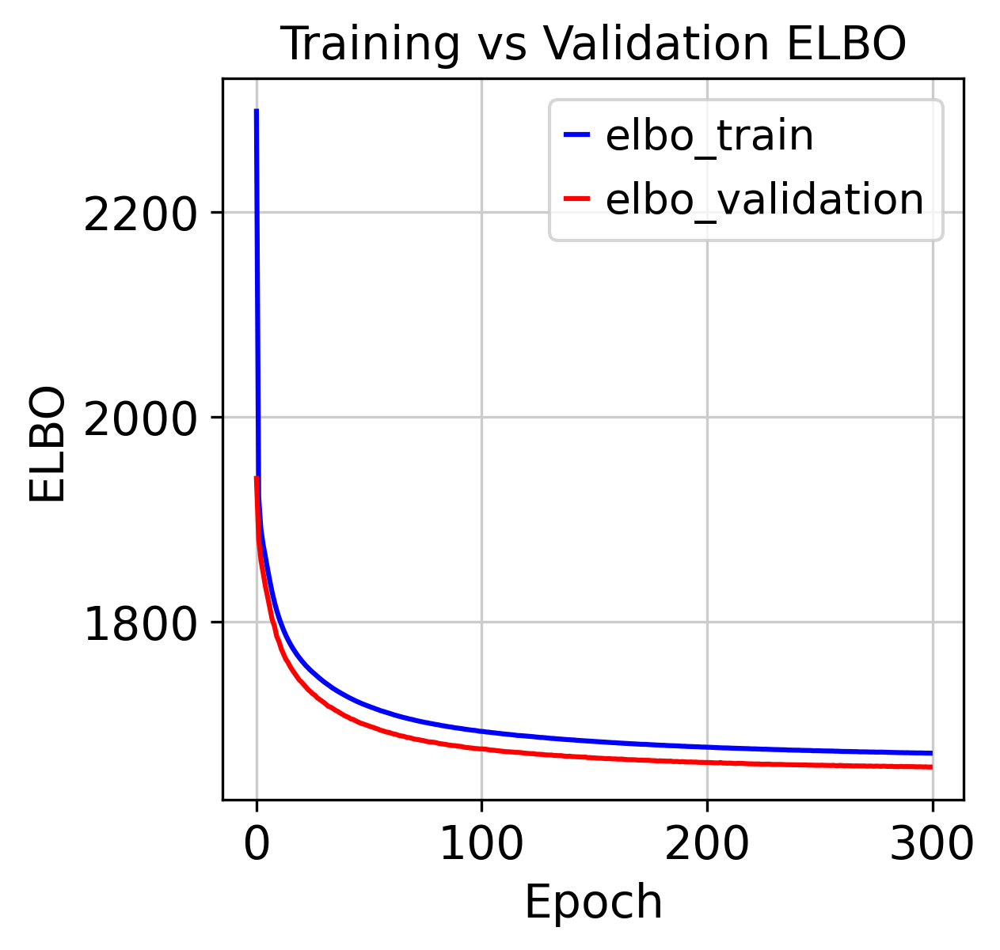

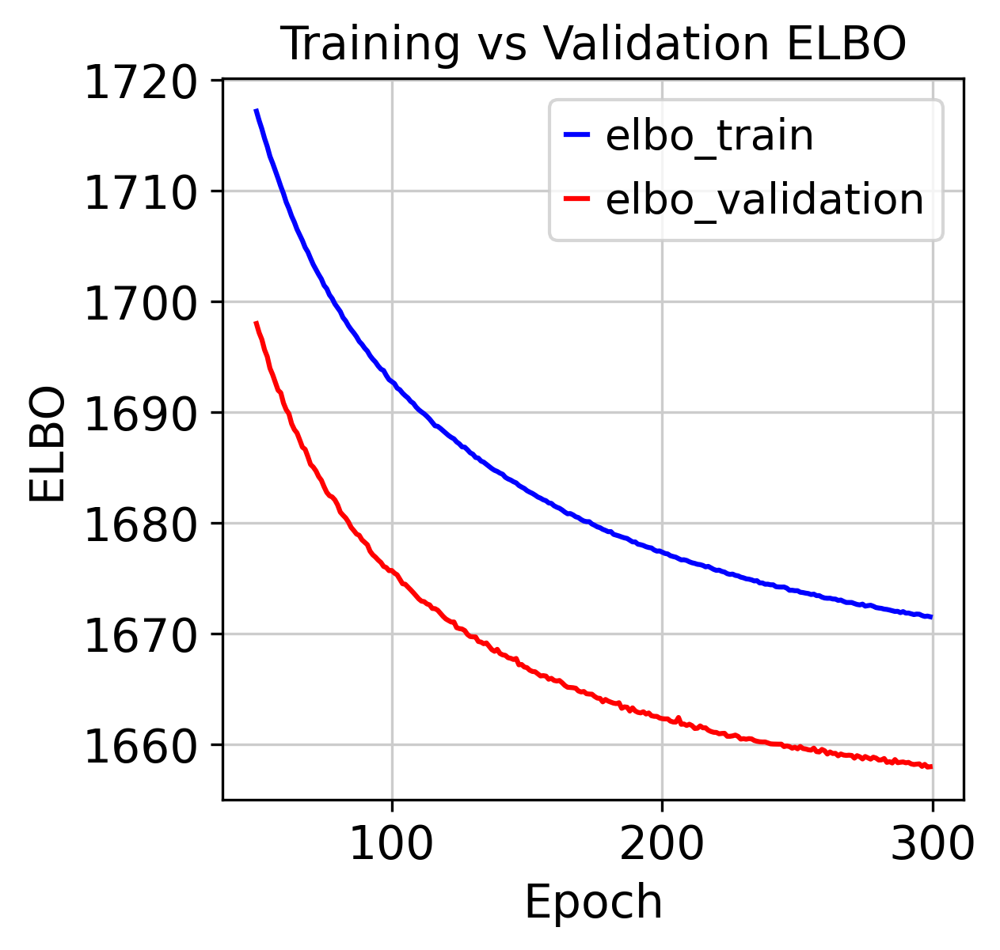

Plotting doublet_metric
Plotting age
Plotting batch_mixing
Plotting cat_covs


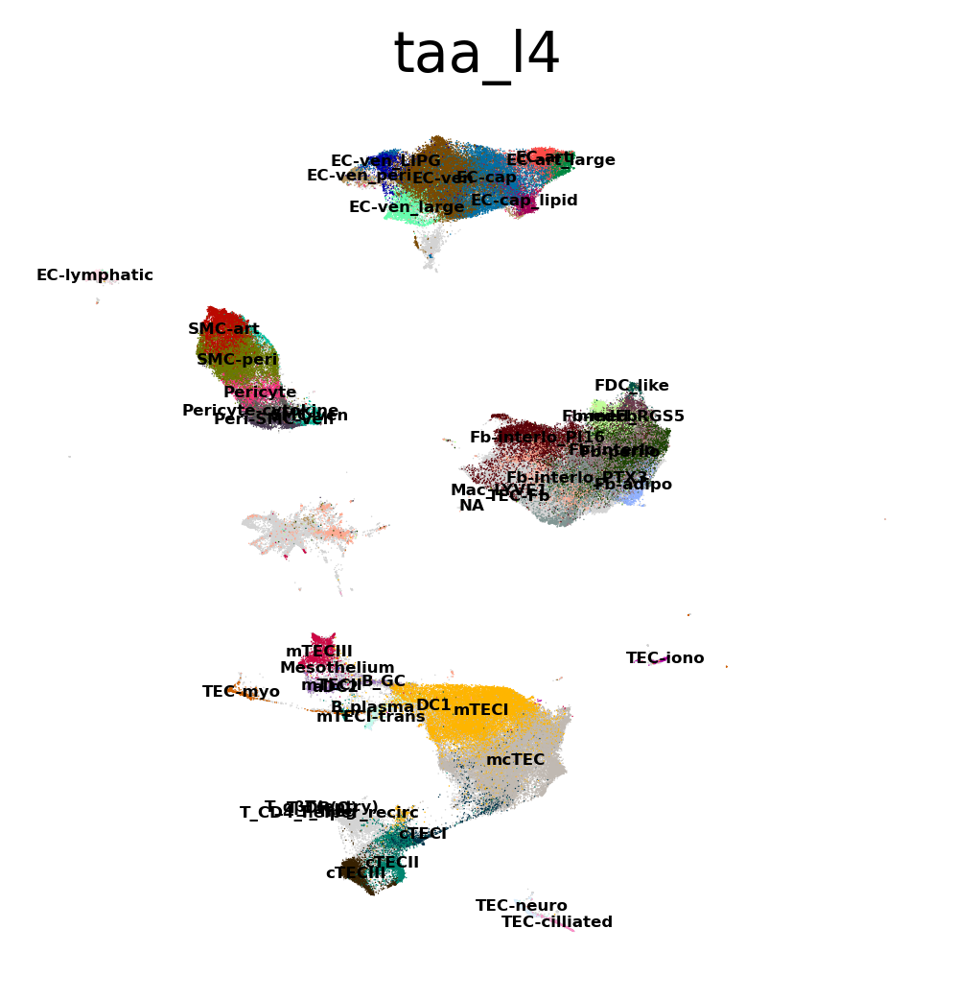

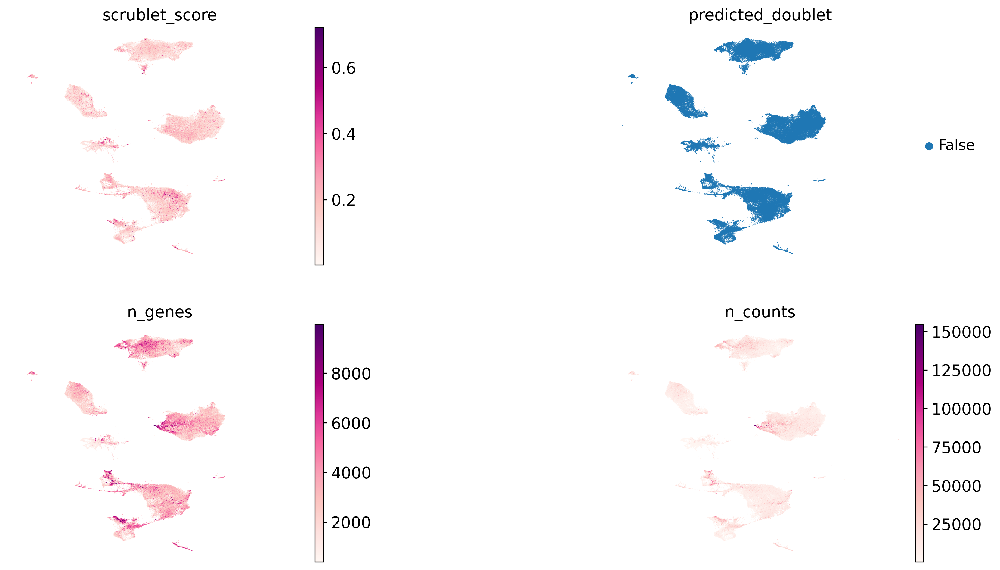

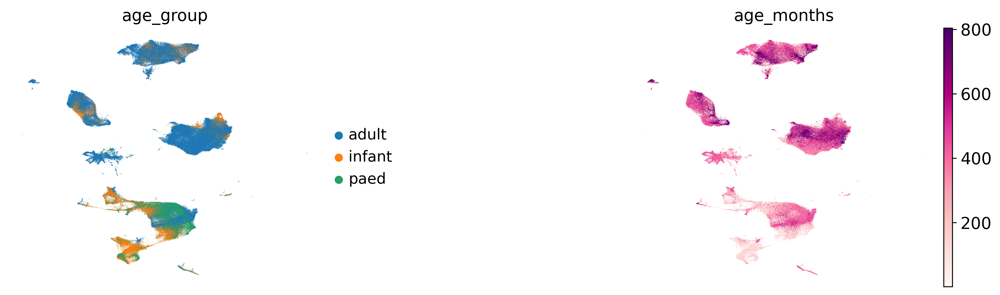

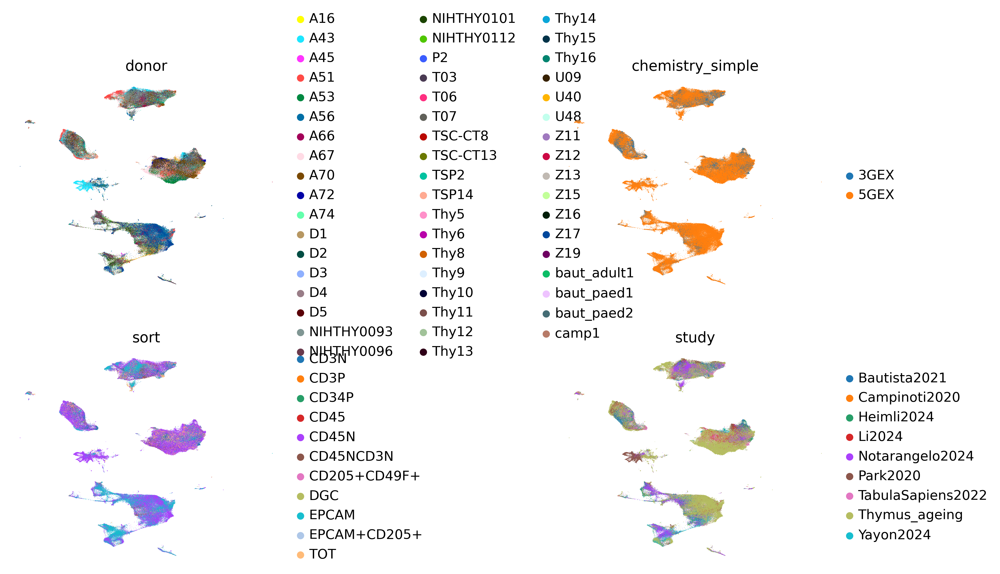

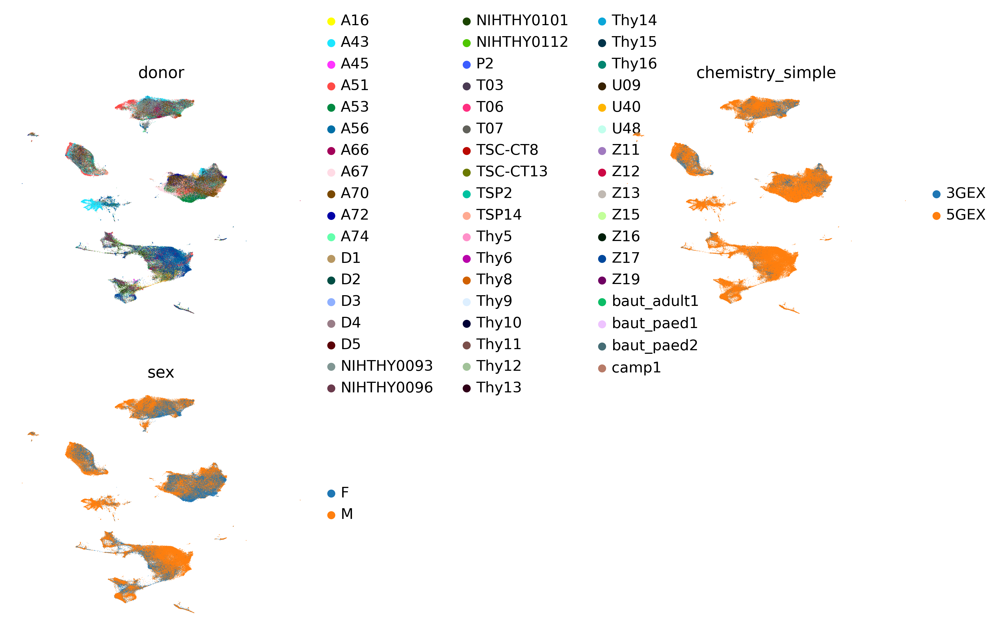

In [26]:
scvi_run = run_scvi(adata, 
                    # Excluded genes
                    include_genes=[], exclude_cc_genes=True, exclude_mt_genes=True, 
                    exclude_vdjgenes = True, remove_cite = False,
                    # Highly variable gene selection
                    batch_hv="age_group", hvg = 10000, span = 0.5,
                    # scVI 
                    batch_scvi="sample",
                    cat_cov_scvi=["donor", "chemistry_simple", "sex"], 
                    cont_cov_scvi=None, max_epochs=300,
                 #   max_epochs=400, batch_size=2000, # early_stopping = True, early_stopping_patience = 10, early_stopping_min_delta = 10,
                    check_val_every_n_epoch = 1,
                    plan_kwargs = {'lr': 0.0001}, n_layers = 2, n_latent = 30, dispersion = 'gene-batch',
                    # Leiden clustering
                    leiden_clustering = None, col_cell_type = 'taa_l4', 
                    covs = {'doublet_metric': ['scrublet_score', 'predicted_doublet', 'n_genes', 'n_counts'],
                    'age': ['age_group', 'age_months'],
                    'batch_mixing': ['donor', 'chemistry_simple', 'sort', 'study']})

In [27]:
adata = scvi_run['data'].copy()

In [28]:
# Save adata and scvi model
scvi_embed_version = 'scvi_v3_2024-11-05_tec-fb-vascSplit'
scvi_obj_version = f'v5_2layers_300epochs_{datetime.now().strftime("%Y-%m-%d")}'
overwrite = True

#anno_cols = [c for c in scvi_run['data'].obs.columns if '_pred_' in c or '_prop_' in c]
if not os.path.exists(f'{data_path}/thyAgeing_{scvi_embed_version}_{scvi_obj_version}.zarr') or overwrite:
#    scvi_run['data'].obs = scvi_run['data'].obs.drop(columns=anno_cols)
    scvi_run['data'].write_h5ad(
        f'{data_path}/objects/thyAgeing_{scvi_embed_version}_{scvi_obj_version}.zarr',
        compression=hdf5plugin.FILTERS["zstd"],
        compression_opts=hdf5plugin.Zstd(clevel=5).filter_options,
    )
    scvi_run['vae'].save(f'{model_path}/thyAgeing_{scvi_embed_version}_{scvi_obj_version}', save_anndata=False, overwrite=False)
else:
    print('File already exists')



adata = ad.read_h5ad (f'{data_path}/objects/thyAgeing_scvi_v3_2024-11-05_tec-fb-vascSplit_v5_2layers_300epochs_2025-01-06.zarr')

In [29]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)

## Load celltypist thymus model to make preliminary annotations

In [30]:
import celltypist
model_taa_l4 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l4_2024-12-10.pkl')

predictions_l4 = celltypist.annotate(adata, model=model_taa_l4, majority_voting = True)
predictions_l4.to_adata(prefix='ctypist_taa_l4')

🔬 Input data has 254685 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 6783 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 30
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 254685 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular', 'ctypist_taa_l4predicted_labels', 'ctypist_taa_l4over_clustering', 'ctypist_taa_l4majority_voting', 'ctypist_taa_l4conf_score'
    var: 'gene_ids', 'gene_name', 'n_counts', 'n_cells'
    uns: 'hvg', '_scv

In [31]:
import celltypist
model_taa_l1 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l1_2024-12-10.pkl')

predictions_l1 = celltypist.annotate(adata, model=model_taa_l1, majority_voting = True)
predictions_l1.to_adata(prefix='ctypist_taa_l1')

🔬 Input data has 254685 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 3962 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 30
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 254685 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular', 'ctypist_taa_l4predicted_labels', 'ctypist_taa_l4over_clustering', 'ctypist_taa_l4majority_voting', 'ctypist_taa_l4conf_score', 'ctypist_taa_l1predicted_labels', 'ctypist_taa_l1over_clustering', 'ctypist_

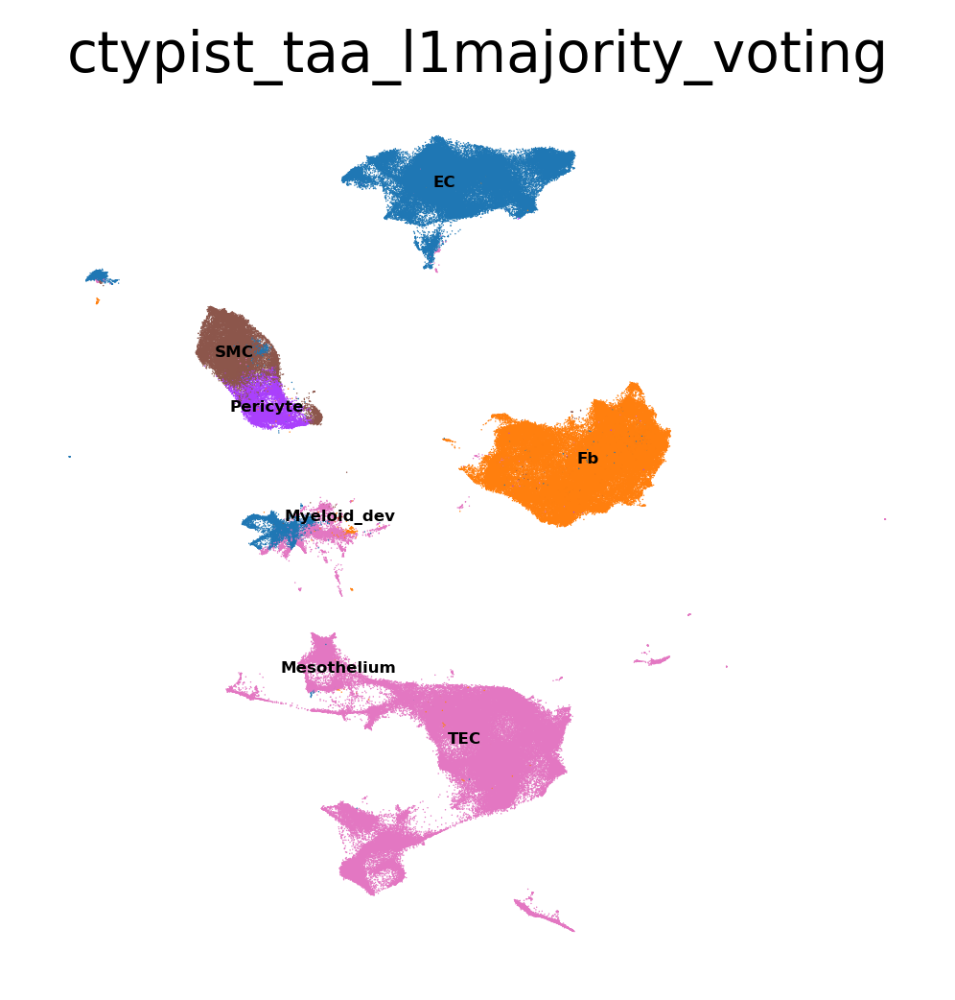

In [32]:
sc.pl.umap(adata, color = ['ctypist_taa_l1majority_voting'], legend_loc = "on data", legend_fontsize = 4, frameon = False)

## Load vasculature model to annotate

In [137]:
import celltypist
from celltypist import models
models.download_models(force_update = True)

📜 Retrieving model list from server https://celltypist.cog.sanger.ac.uk/models/models.json
📚 Total models in list: 53
📂 Storing models in /nfs/users/nfs_v/vk8/.celltypist/data/models
💾 Downloading model [1/53]: Immune_All_Low.pkl
💾 Downloading model [2/53]: Immune_All_High.pkl
💾 Downloading model [3/53]: Adult_COVID19_PBMC.pkl
💾 Downloading model [4/53]: Adult_CynomolgusMacaque_Hippocampus.pkl
💾 Downloading model [5/53]: Adult_Human_MTG.pkl
💾 Downloading model [6/53]: Adult_Human_PancreaticIslet.pkl
💾 Downloading model [7/53]: Adult_Human_PrefrontalCortex.pkl
💾 Downloading model [8/53]: Adult_Human_Skin.pkl
💾 Downloading model [9/53]: Adult_Human_Vascular.pkl
💾 Downloading model [10/53]: Adult_Mouse_Gut.pkl
💾 Downloading model [11/53]: Adult_Mouse_OlfactoryBulb.pkl
💾 Downloading model [12/53]: Adult_Pig_Hippocampus.pkl
💾 Downloading model [13/53]: Adult_RhesusMacaque_Hippocampus.pkl
💾 Downloading model [14/53]: Autopsy_COVID19_Lung.pkl
💾 Downloading model [15/53]: COVID19_HumanChalleng

In [138]:
vasc_model = models.Model.load(model = 'Adult_Human_Vascular.pkl')

In [139]:
predictions_vasc = celltypist.annotate(adata, model=vasc_model, majority_voting = True)
predictions_vasc.to_adata(prefix='ctypist_vasc')

🔬 Input data has 254685 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 3520 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 30
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 254685 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'doublet', 'stroma-anno1-coarse', 'stroma-anno1-granular', 'ctypist_taa_l4predicted_labels', 'ctypist_taa_l4over_clustering', 'ctypist_taa_l4majority_voting', 'ctypist_taa_l4conf_score', 'ctypist_taa_l1predicted_labels', 'ctypist_taa_l1over_clustering', 'ctypist_

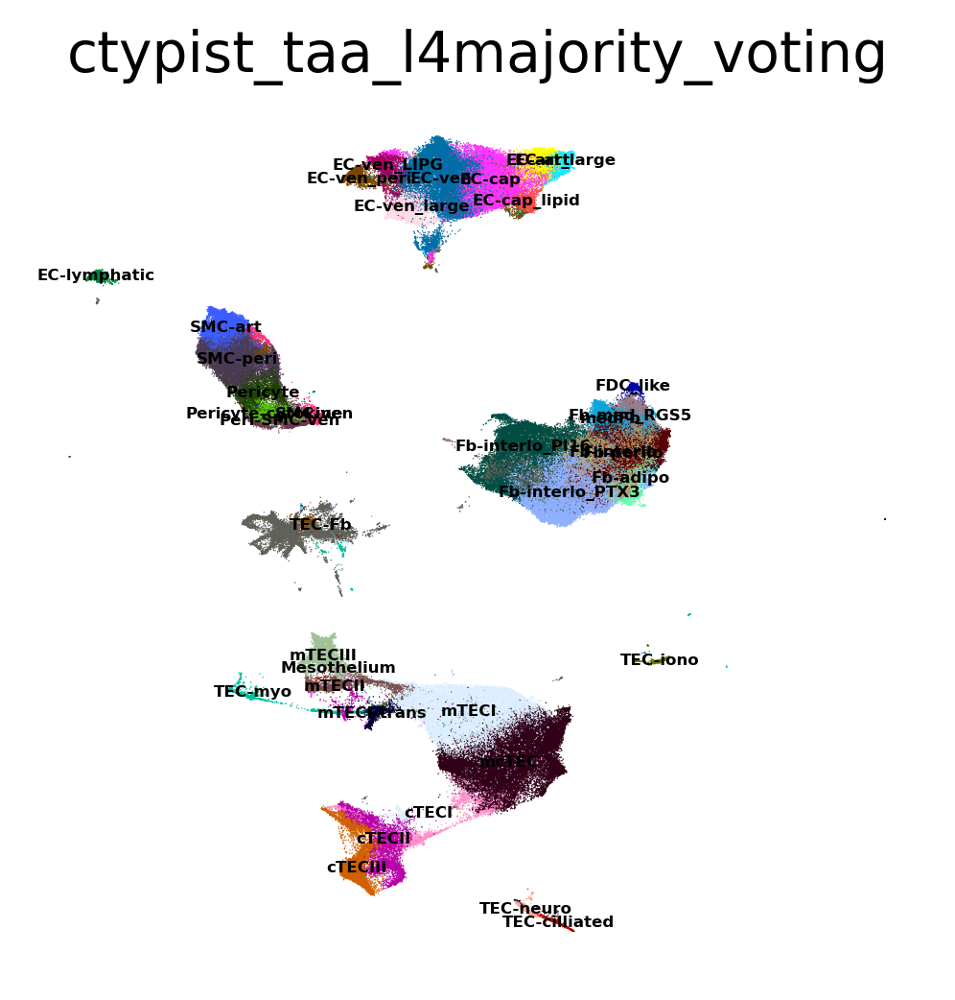

In [33]:
sc.pl.umap(adata, color = ['ctypist_taa_l4majority_voting'], legend_loc = "on data", legend_fontsize = 4, frameon = False)

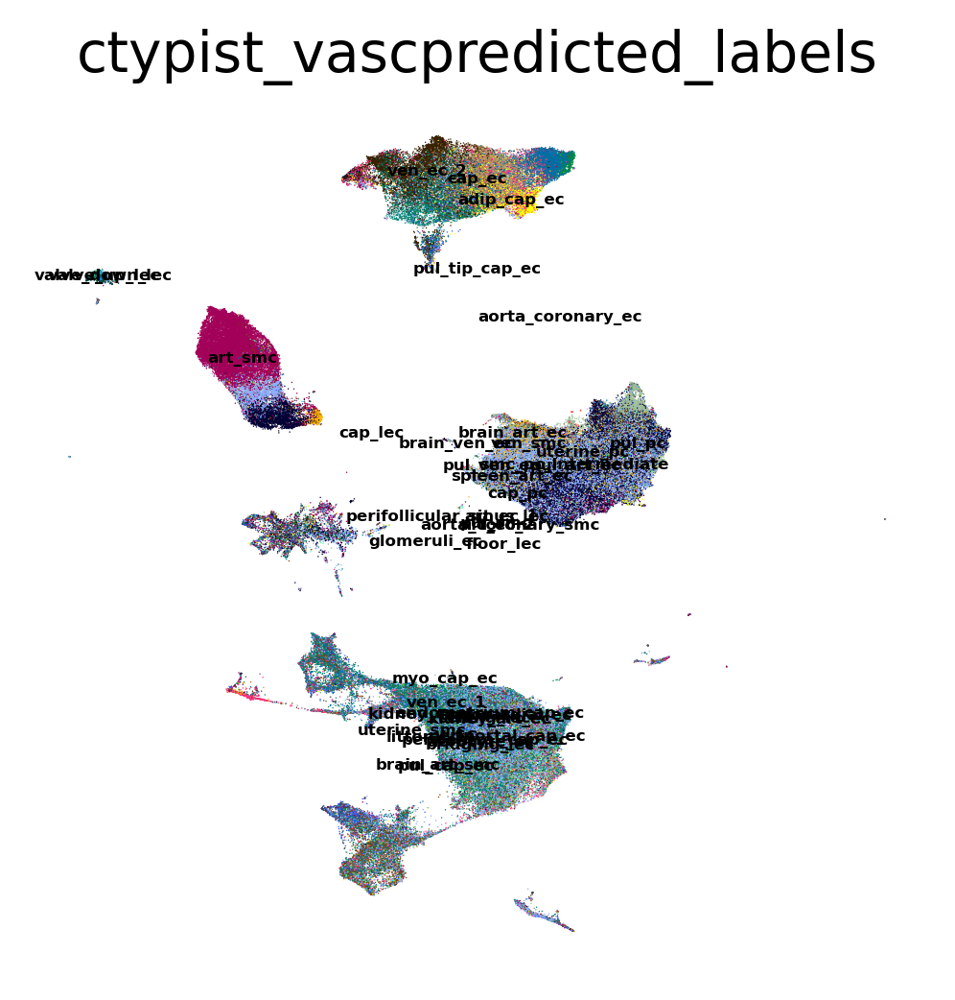

In [140]:
sc.pl.umap(adata, color = ['ctypist_vascpredicted_labels'], legend_loc = "on data", legend_fontsize = 4, frameon = False)

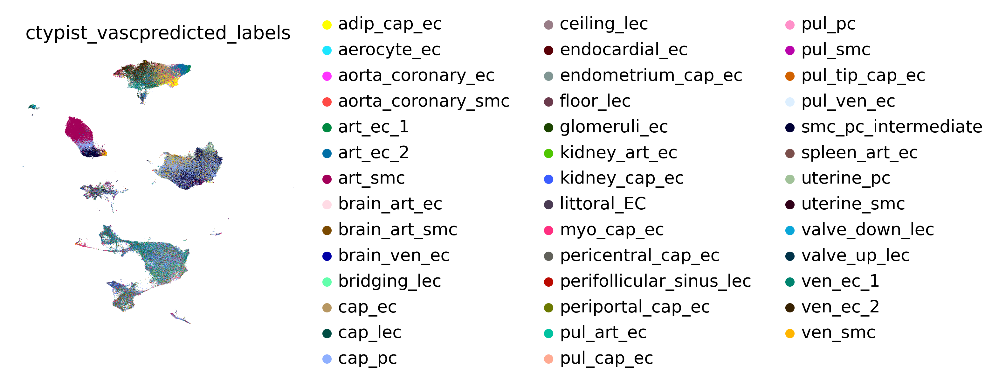

In [142]:
sc.pl.umap(adata, color = ['ctypist_vascpredicted_labels'], frameon = False)

In [42]:
## Check EMT signature 
emt_markers = {'epi': ['KRT5', 'KRT15', 'KRT14', 'CDH1'],
               'epi_integrity': ['CDH1', 'OCLN', 'TJP1'],
                'mesenchymal': ['CDH2', 'FN', 'VIM'],
                'vasc/smc': ['ACTA2', 'MYH11', 'CDH5'],
                'tfs': ['SNAIL', 'SLUG', 'TWIST1', 'ZEB1', 'ZEB2']}

emt_markers_lst = []
[emt_markers_lst.extend(emt_markers[key]) for key in emt_markers.keys()]

[None, None, None, None, None]

In [44]:
emt_markers_lst = [i for i in emt_markers_lst if i in adata.var_names]

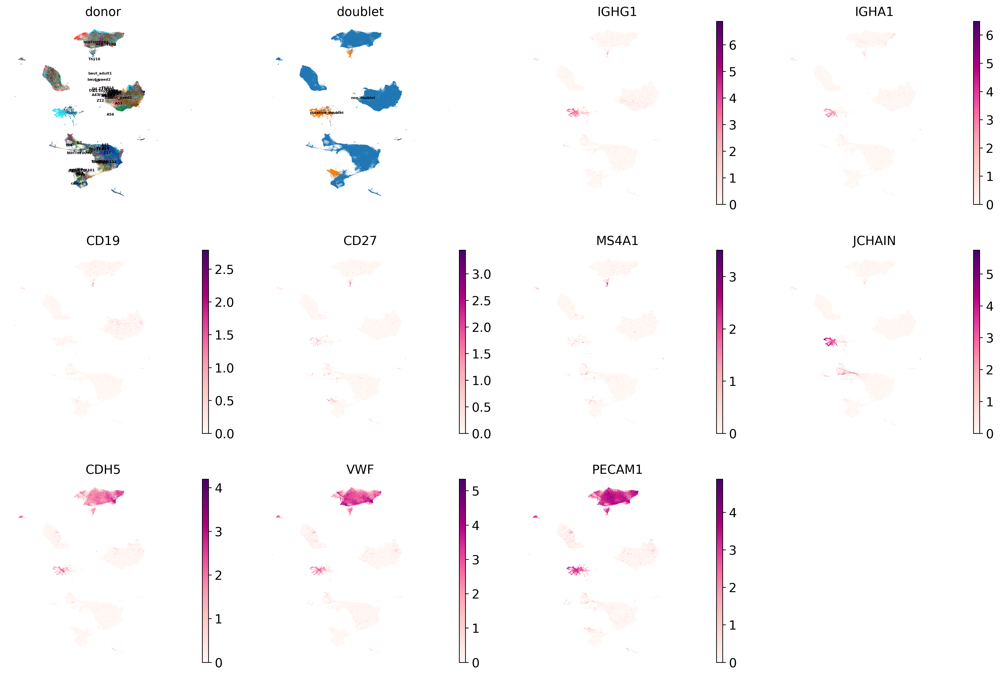

In [48]:
sc.pl.umap(adata, color = ['donor', 'doublet', 'IGHG1', 'IGHA1', 'CD19','CD27', 'MS4A1', 'JCHAIN', 
                           'CDH5', 'VWF', 'PECAM1'], legend_loc = "on data", legend_fontsize = 4, frameon = False)

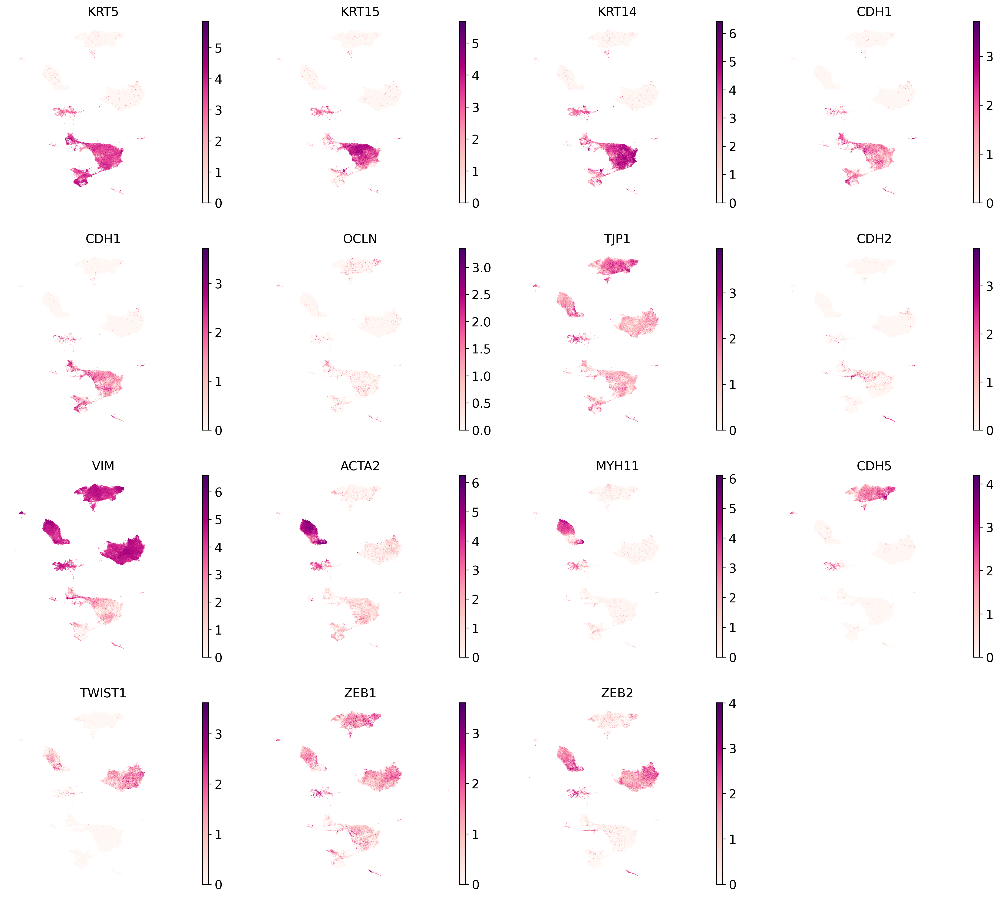

In [45]:
sc.pl.umap(adata, color = emt_markers_lst, legend_loc = "on data", legend_fontsize = 4, frameon = False)

In [50]:
def run_leiden(adata, resolutions, key_name,restrict_to = None, legend_loc = "on data", legend_fontsize = 4):
    for r in resolutions:
        if restrict_to:
            sc.tl.leiden(adata, restrict_to = restrict_to, resolution = r, key_added = f'leiden_r{str(r)}',
                        flavor="igraph", n_iterations=2)
        else:
            sc.tl.leiden(adata, resolution = r, key_added = f'{key_name}-leiden_r{str(r)}',
                        flavor="igraph", n_iterations=2)
    sc.pl.umap(adata, color = [f'{key_name}-leiden_r{str(r)}' for r in resolutions] , legend_loc = legend_loc, legend_fontsize = legend_fontsize)

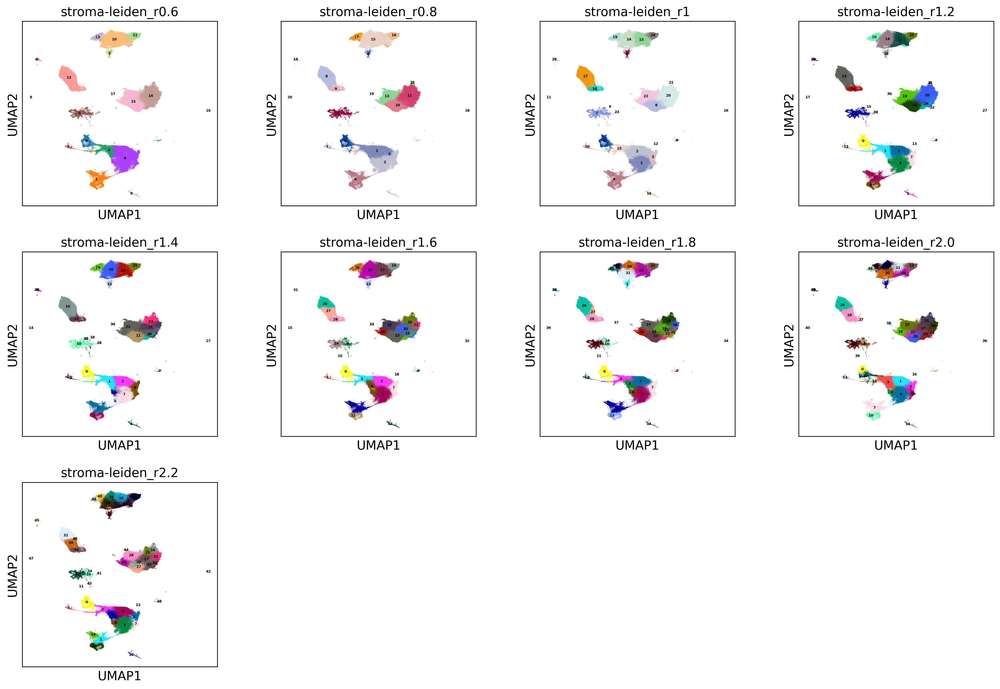

In [51]:
run_leiden(adata, resolutions = [0.6,0.8,1,1.2,1.4,1.6, 1.8, 2.0, 2.2] , key_name = 'stroma')

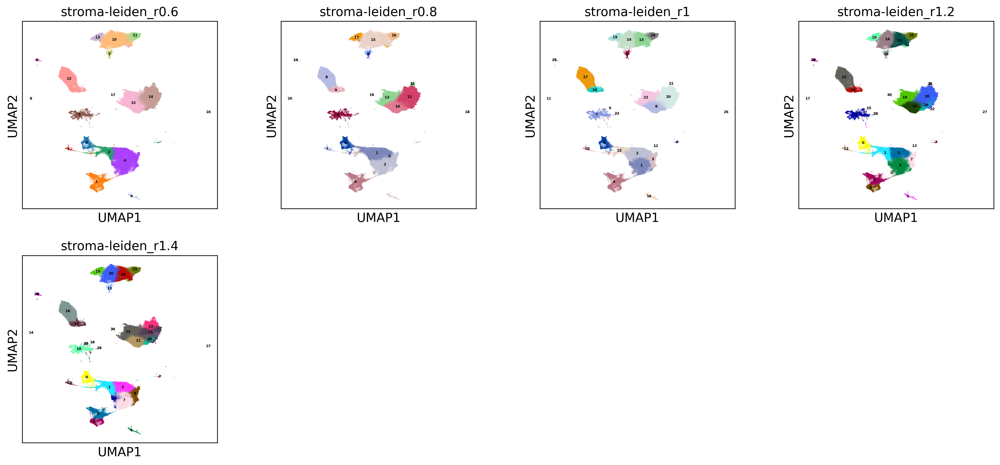

In [52]:
sc.pl.umap(adata, color = [f'stroma-leiden_r{str(r)}' for r in [0.6,0.8,1,1.2,1.4]] , legend_loc = "on data", legend_fontsize = 4)

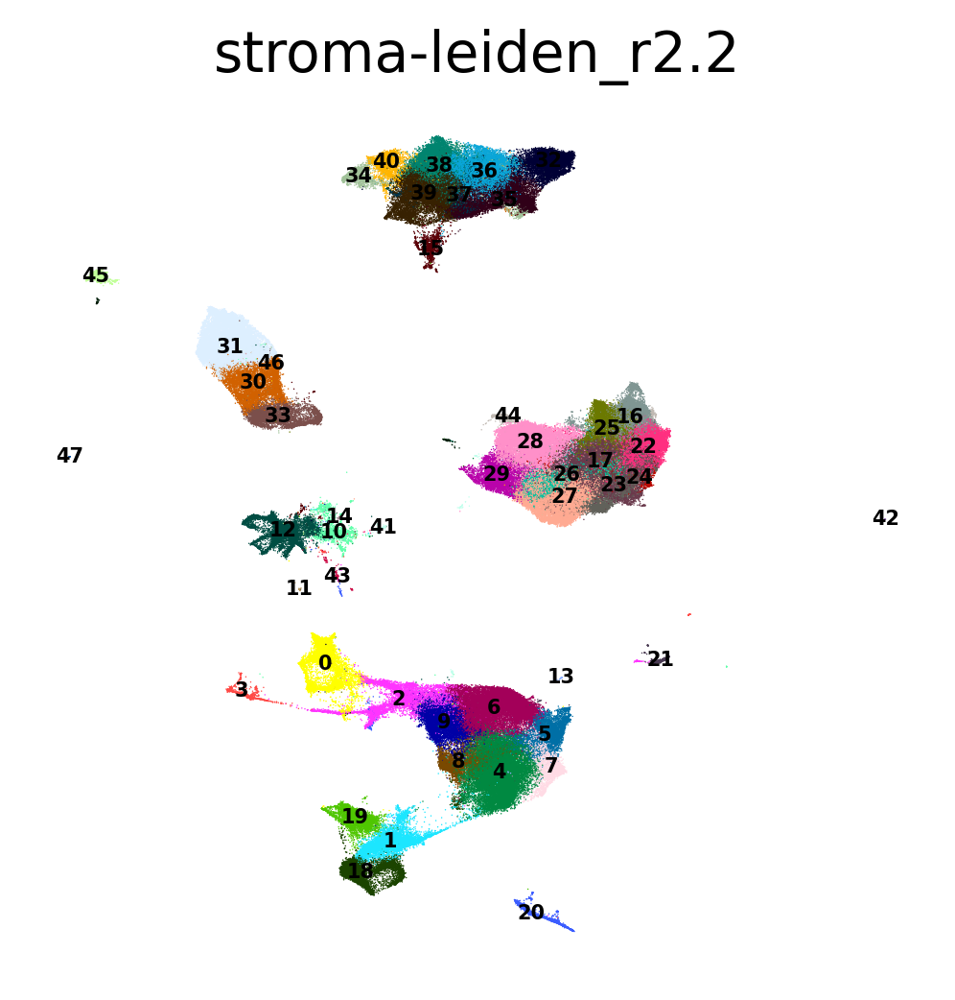

In [53]:
sc.pl.umap(adata, color = ['stroma-leiden_r2.2'] , legend_loc = "on data", legend_fontsize = 5, frameon = False)

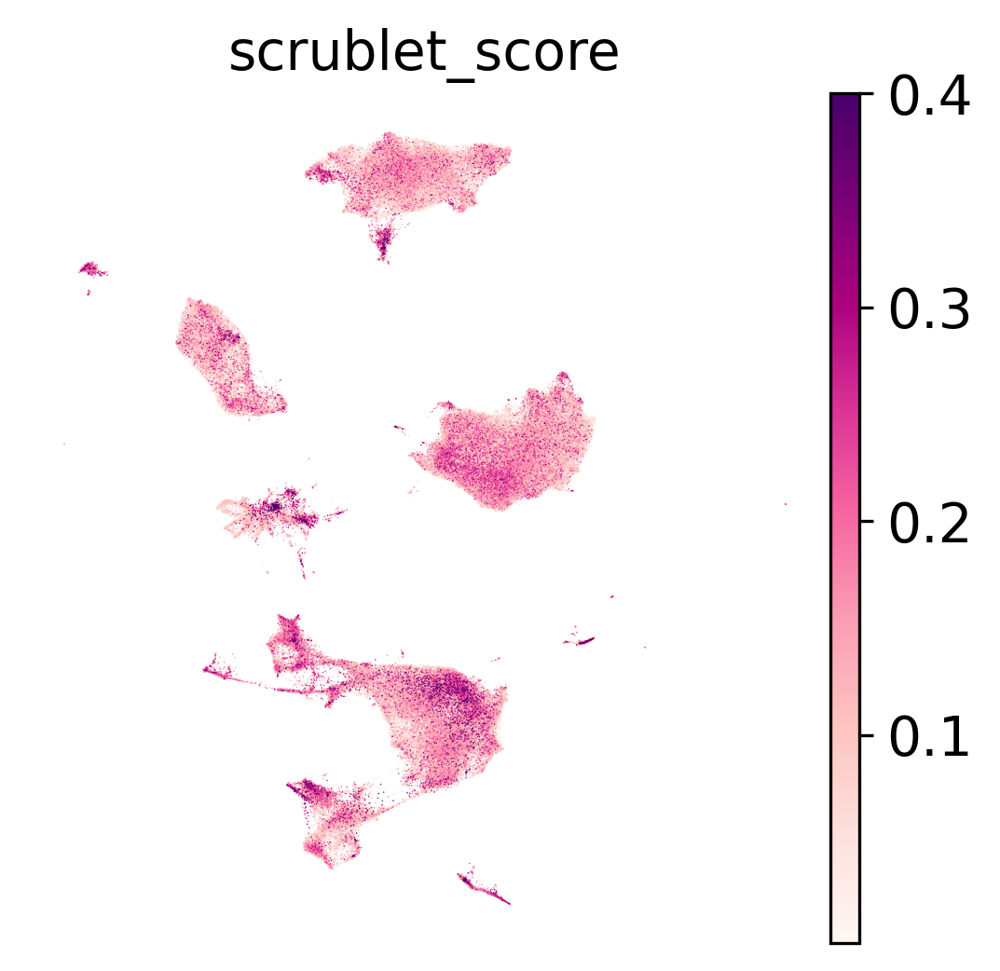

In [54]:
sc.pl.umap(adata, color = ['scrublet_score'] , vmax = 0.4, legend_loc = "on data", legend_fontsize = 5, frameon = False)

In [55]:
sc.pl.umap(adata, color = general_mrkrs, legend_loc = "on data", legend_fontsize = 5, frameon = False)

In [65]:
TEC_mrkrs = ['KRT5', 'KRT15', 'KRT8', 'KRT18','CDH1', 'LY75', 'PSMB11', 'EPCAM', 'AIRE', 'OCLN',
 'TJP1']
emt_mrkrs = ['CDH2','VIM','ACTA2', 'MYH11','TWIST1','ZEB1','ZEB2']
Fb_mrkrs = ['PDGFRA','FBN1', 'COLEC11']
Vasc_mrkrs = ['PECAM1', 'CDH5','VWF', "RGS5","ABCC9", "PDGFRB", "ACTA2", "MYH11"]
T_mrkrs = ['PTPRC', 'CD3G', 'CD8A', 'CD8B', 'CD4', 'TRDC']
B_mrkrs = ['IGHG1', 'IGHA1', 'CD19', 'MZB1', 'JCHAIN']
Ery_mrkrs = ['GYPA', 'HBA1', 'HBG1']

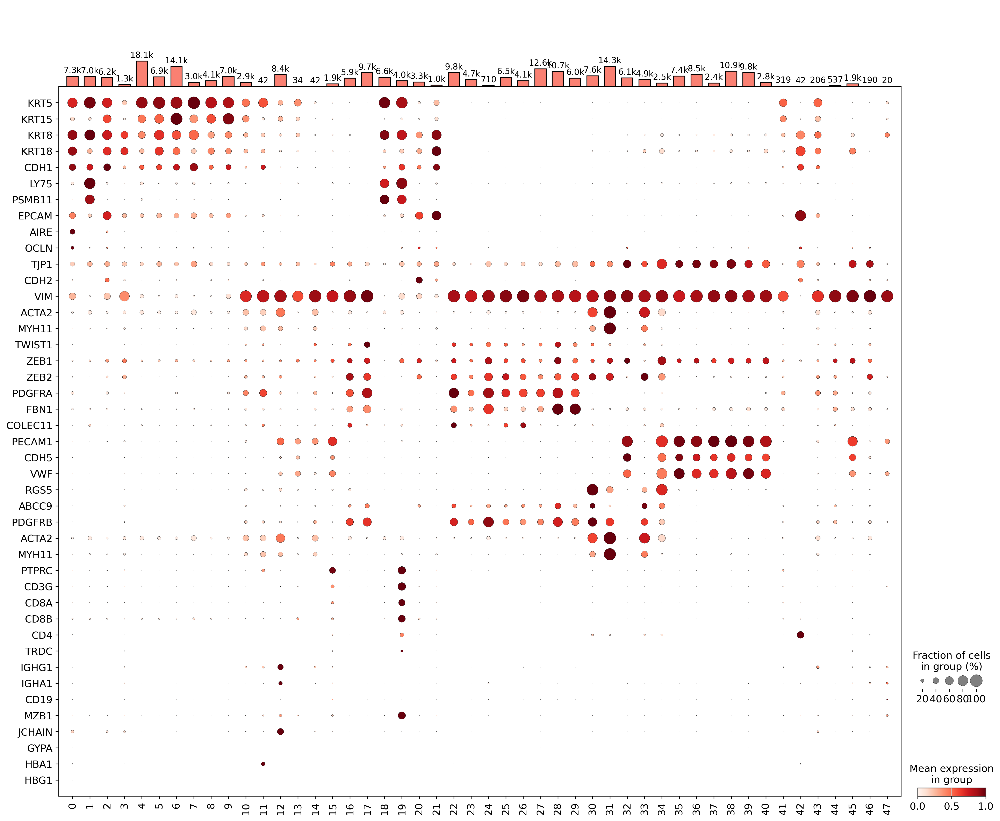

In [67]:
dp_dbl = sc.pl.dotplot (adata, var_names = TEC_mrkrs+emt_mrkrs+Fb_mrkrs+Vasc_mrkrs+T_mrkrs+B_mrkrs+Ery_mrkrs
                        , 
               groupby = 'stroma-leiden_r2.2', swap_axes = True, standard_scale='var', return_fig = True)

dp_dbl.add_totals()
dp_dbl.show()

In [69]:
doublet_map = {
 '13': 'TEC-vasc(small)',#delete?
 '15' : 'T-vasc_doublet', #delete?
 '19' : 'TEC-DP_doublet', # retain
 '42': 'CD4-TEC_doublet(small)', # delete
 '44': 'Fibro-pericyte(small)', # retain
'47': 'TEC-fb_imm(small)'
}

In [71]:
adata.obs['stroma-leiden_r2.2_temp'] = adata.obs['stroma-leiden_r2.2'].copy()

In [72]:
adata.obs['stroma-leiden_r2.2_temp'] = adata.obs['stroma-leiden_r2.2'].apply(lambda x:'EMT' if x in ['10', '11', '12', '14','41', '43'] else
                                                                                 x)

In [74]:
sc.tl.leiden(adata, resolution=0.8, restrict_to=['stroma-leiden_r2.2_temp', ['EMT']], key_added = 'stroma-leiden_EMT')

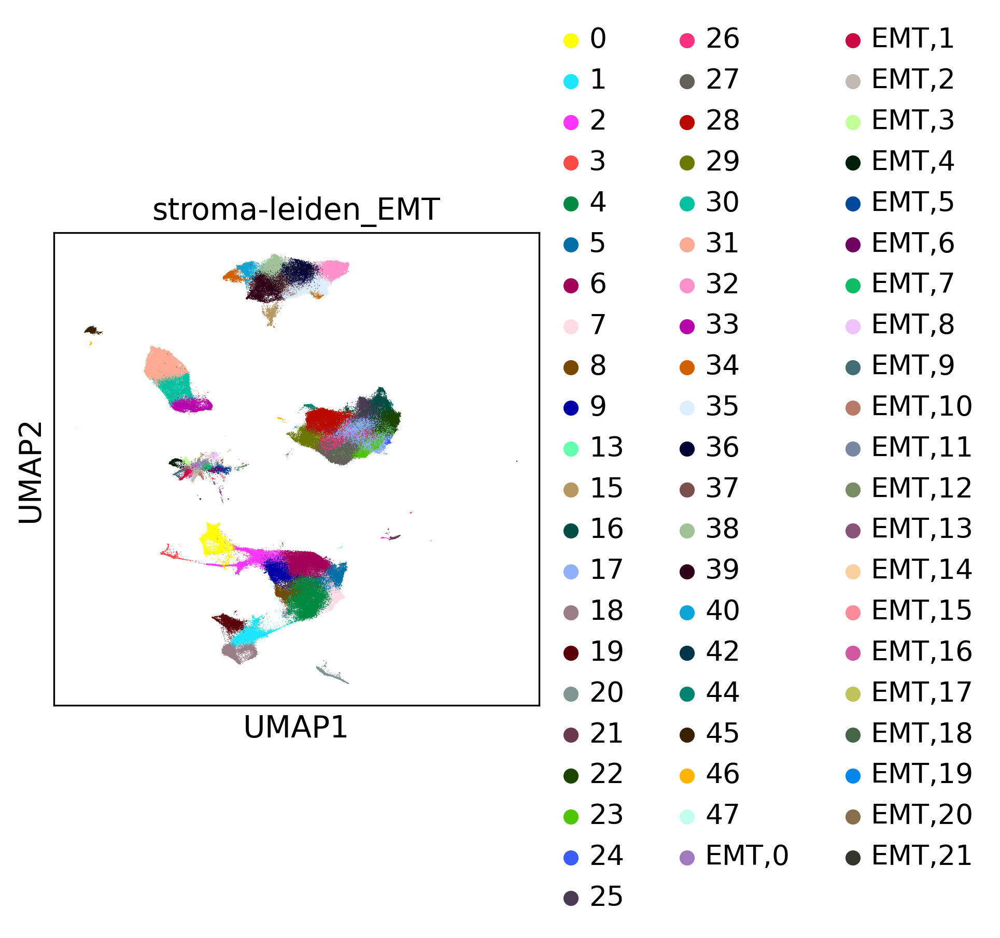

In [75]:
sc.pl.umap(adata, color = 'stroma-leiden_EMT')

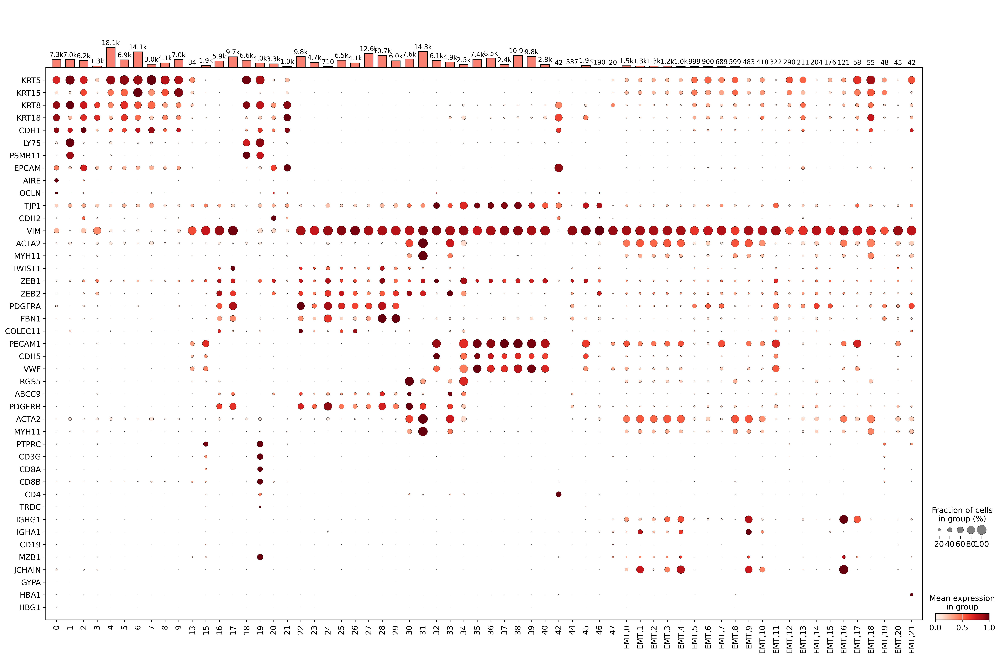

In [76]:
dp_dbl = sc.pl.dotplot (adata, var_names = TEC_mrkrs+emt_mrkrs+Fb_mrkrs+Vasc_mrkrs+T_mrkrs+B_mrkrs+Ery_mrkrs
                        , 
               groupby = 'stroma-leiden_EMT', swap_axes = True, standard_scale='var', return_fig = True)

dp_dbl.add_totals()
dp_dbl.show()

In [79]:
EMT_cats = [i for i in adata.obs['stroma-leiden_EMT'].cat.categories if 'EMT' in i]
EMT_cats

['EMT,0',
 'EMT,1',
 'EMT,2',
 'EMT,3',
 'EMT,4',
 'EMT,5',
 'EMT,6',
 'EMT,7',
 'EMT,8',
 'EMT,9',
 'EMT,10',
 'EMT,11',
 'EMT,12',
 'EMT,13',
 'EMT,14',
 'EMT,15',
 'EMT,16',
 'EMT,17',
 'EMT,18',
 'EMT,19',
 'EMT,20',
 'EMT,21']

In [80]:
EMT_nondbls = ['EMT,5','EMT,6','EMT,7','EMT,8', 'EMT,11','EMT,12','EMT,13','EMT,14','EMT,15','EMT,18','EMT,20']
 

In [87]:
[EMT_cats.remove(i) for i in EMT_nondbls]

[None, None, None, None, None, None, None, None, None, None, None]

In [90]:
EMT_cats

['EMT,0',
 'EMT,1',
 'EMT,2',
 'EMT,3',
 'EMT,4',
 'EMT,9',
 'EMT,10',
 'EMT,16',
 'EMT,17',
 'EMT,19',
 'EMT,21']

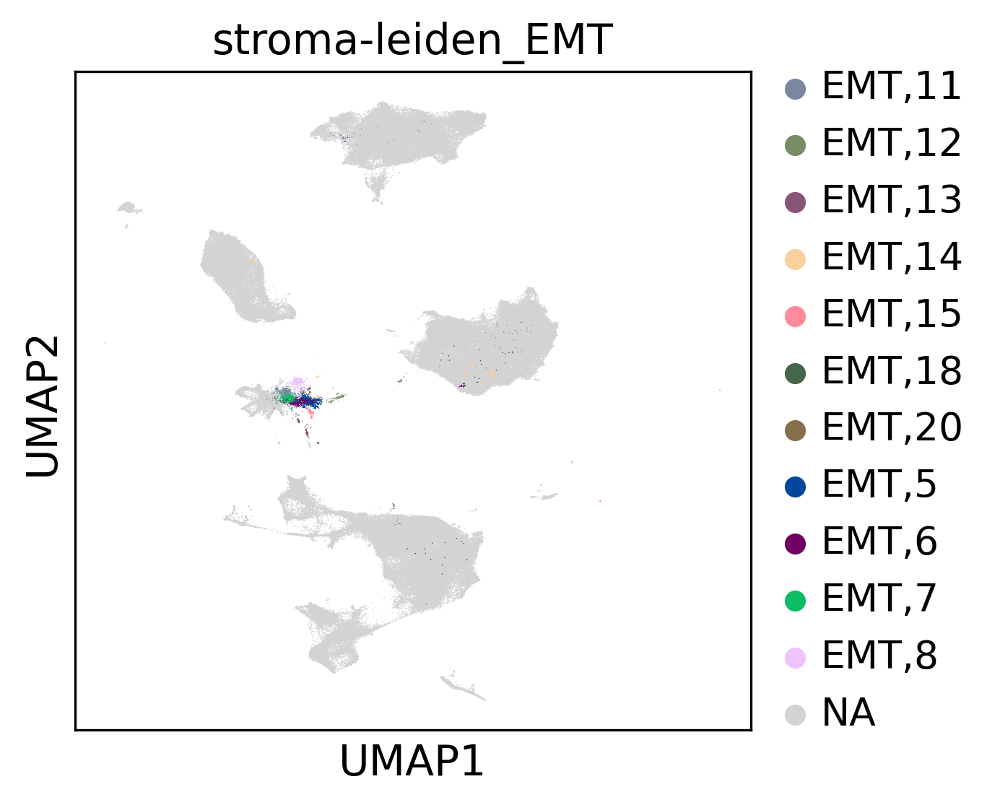

In [81]:
sc.pl.umap(adata, color = 'stroma-leiden_EMT', groups = EMT_nondbls)

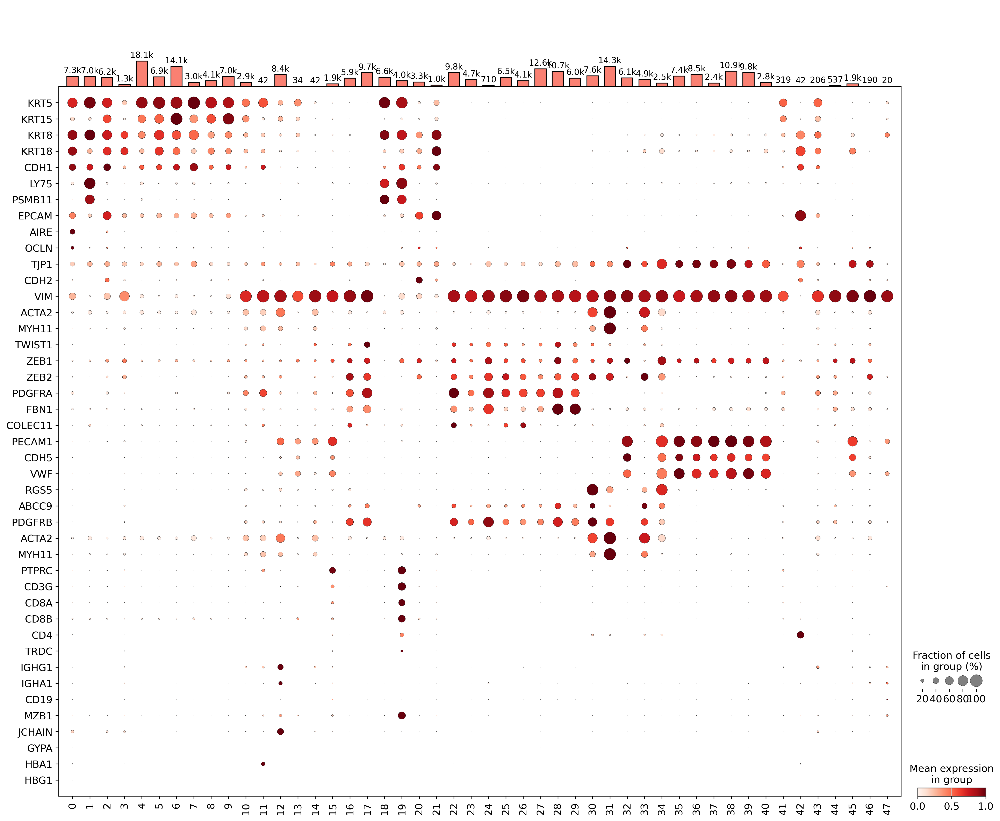

In [67]:
dp_dbl = sc.pl.dotplot (adata, var_names = TEC_mrkrs+emt_mrkrs+Fb_mrkrs+Vasc_mrkrs+T_mrkrs+B_mrkrs+Ery_mrkrs
                        , 
               groupby = 'stroma-leiden_r2.2', swap_axes = True, standard_scale='var', return_fig = True)

dp_dbl.add_totals()
dp_dbl.show()

In [103]:
doublet_map = {
 '13': 'TEC-vasc(small)',#delete
 '15' : 'T-vasc_doublet', # retain
 '19' : 'TEC-DP_doublet', # retain
 '42': 'CD4-TEC_doublet(small)', # delete
 '44': 'Fibro-pericyte(small)', # retain
'47': 'TEC-fb_imm(small)' # delete
}

for i in EMT_cats:
    doublet_map[i] = 'EMT-TEC-Bcells'

In [104]:
doublet_map

{'13': 'TEC-vasc(small)',
 '15': 'T-vasc_doublet',
 '19': 'TEC-DP_doublet',
 '42': 'CD4-TEC_doublet(small)',
 '44': 'Fibro-pericyte(small)',
 '47': 'TEC-fb_imm(small)',
 'EMT,0': 'EMT-TEC-Bcells',
 'EMT,1': 'EMT-TEC-Bcells',
 'EMT,2': 'EMT-TEC-Bcells',
 'EMT,3': 'EMT-TEC-Bcells',
 'EMT,4': 'EMT-TEC-Bcells',
 'EMT,9': 'EMT-TEC-Bcells',
 'EMT,10': 'EMT-TEC-Bcells',
 'EMT,16': 'EMT-TEC-Bcells',
 'EMT,17': 'EMT-TEC-Bcells',
 'EMT,19': 'EMT-TEC-Bcells',
 'EMT,21': 'EMT-TEC-Bcells'}

In [96]:
dbls = EMT_cats+['13', '42', '47']
pot_dbls = ['15', '19', '44']

In [106]:
adata.obs['doublet'] = adata.obs['stroma-leiden_EMT'].apply(lambda x: 'manual_doublet' if x in dbls else
                                                                      'putative_doublet' if x in pot_dbls else
                                                           'non-doublet')

adata.obs['doublet_verbose'] = adata.obs['stroma-leiden_EMT'].map(doublet_map)

In [107]:
adata.obs['stroma-anno2-coarse'] = adata.obs['ctypist_taa_l1majority_voting'].copy()
adata.obs['stroma-anno2-granular'] = adata.obs['ctypist_taa_l4majority_voting'].copy()

In [24]:
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

... storing 'doublet' as categorical
... storing 'doublet_verbose' as categorical


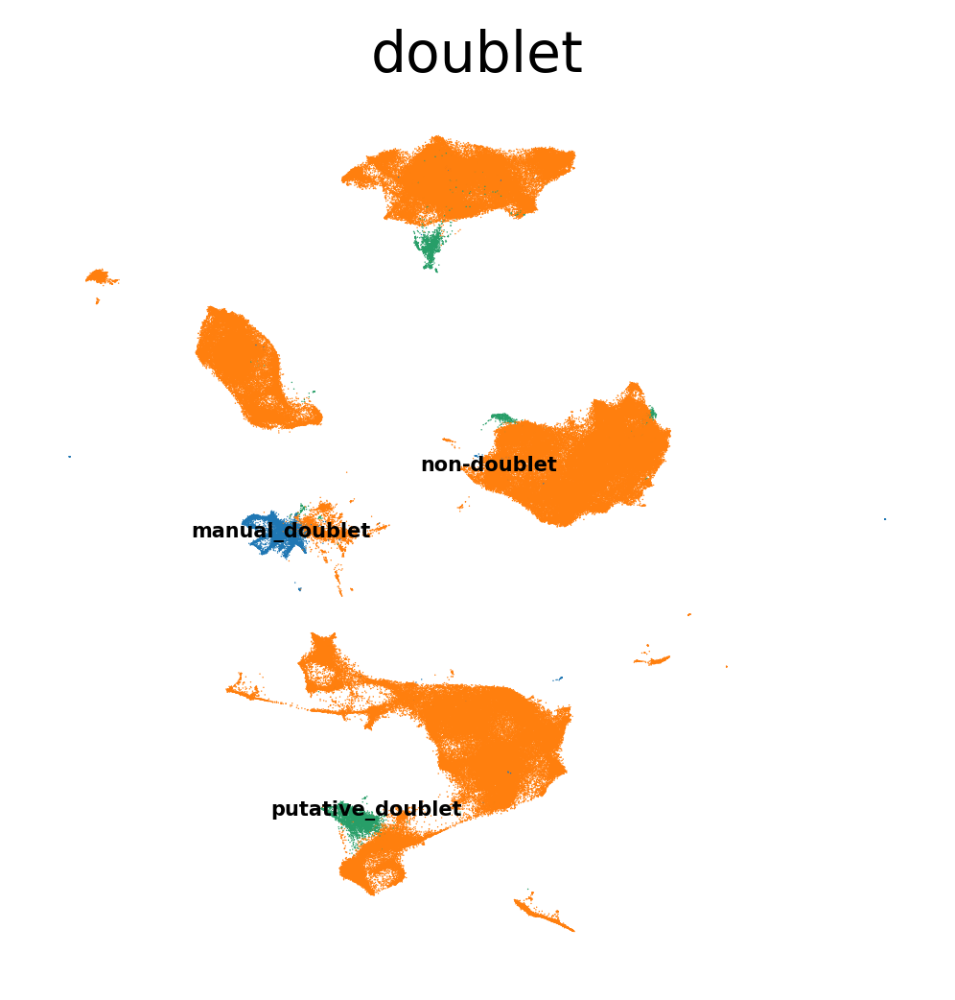

In [108]:
sc.pl.umap(adata, color = ['doublet'] , legend_loc = "on data", legend_fontsize = 5, frameon = False)

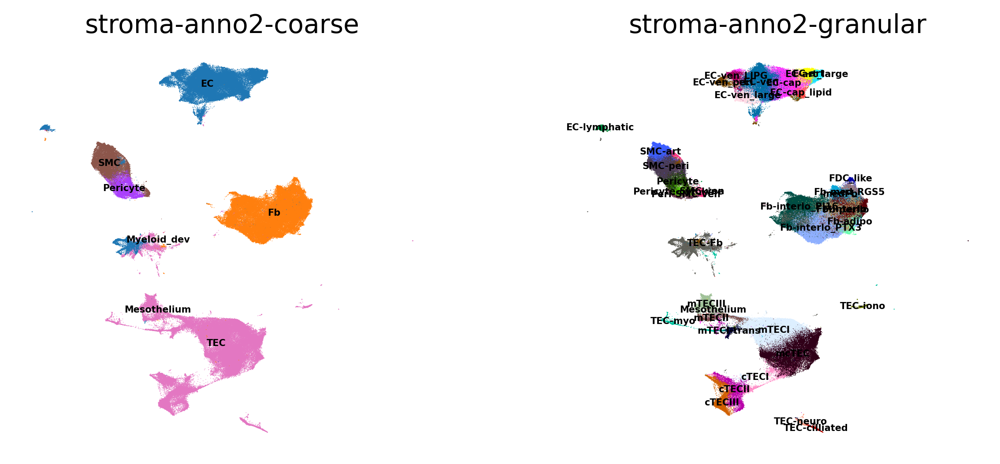

In [110]:
sc.pl.umap(adata, color = ['stroma-anno2-coarse', 'stroma-anno2-granular'] , legend_loc = "on data", legend_fontsize = 5, frameon = False)

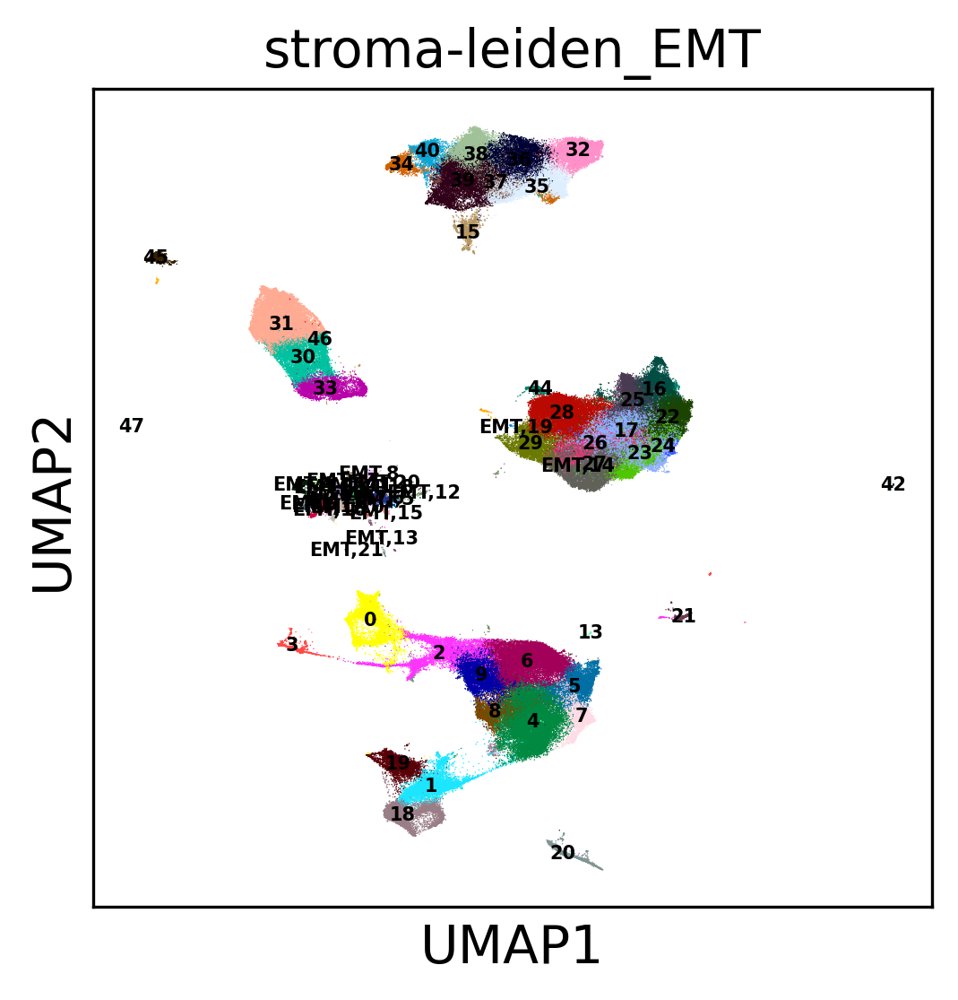

In [113]:
sc.pl.umap(adata, color = 'stroma-leiden_EMT', legend_loc = 'on data', legend_fontsize = 5)

In [115]:
smc = ['31']
peri = ['30', '33', '46']
ecs = ['45', '34', '40', '38', '39', '36', '37', '15', '35', '32']
fibro  = ['28', '29', '44', '17', '26', '27', '22', '23', '24', '25', '16']
tecs = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '13', '18', '19', '20', '21']

In [117]:
pd.crosstab(adata.obs['stroma-anno2-coarse'], adata.obs['doublet'])

doublet,manual_doublet,non-doublet,putative_doublet
stroma-anno2-coarse,,,
EC,6107,53040,1756
Fb,4,71077,538
Mesothelium,0,6,0
Myeloid_dev,0,45,0
Pericyte,0,7993,0
SMC,4,18652,29
TEC,1440,89832,4162


In [116]:
adata.obs['stroma-anno2-coarse'].value_counts()

stroma-anno2-coarse
TEC            95434
Fb             71619
EC             60903
SMC            18685
Pericyte        7993
Myeloid_dev       45
Mesothelium        6
Name: count, dtype: int64

In [118]:
adata.obs['stroma-anno2-coarse'] = adata.obs.apply (lambda x: 'doublet' if x['doublet'] == 'manual_doublet' else
                                                    'EC' if x['stroma-leiden_EMT'] in ecs else
                                                    'SMC' if x['stroma-leiden_EMT'] in smc else
                                                    'Pericyte' if x['stroma-leiden_EMT'] in peri else
                                                    'Fb' if x['stroma-leiden_EMT'] in fibro else
                                                    'TEC' if x['stroma-leiden_EMT'] in tecs else
                                                    'TEC-EMT', axis = 1)

In [136]:
adata.obs.to_csv(f'{data_path}/objects/thyAgeing_scvi_v3_2024-11-05_tec-fb-vascSplit_doubl_anno2_{datetime.now().strftime("%Y-%m-%d")}.csv')

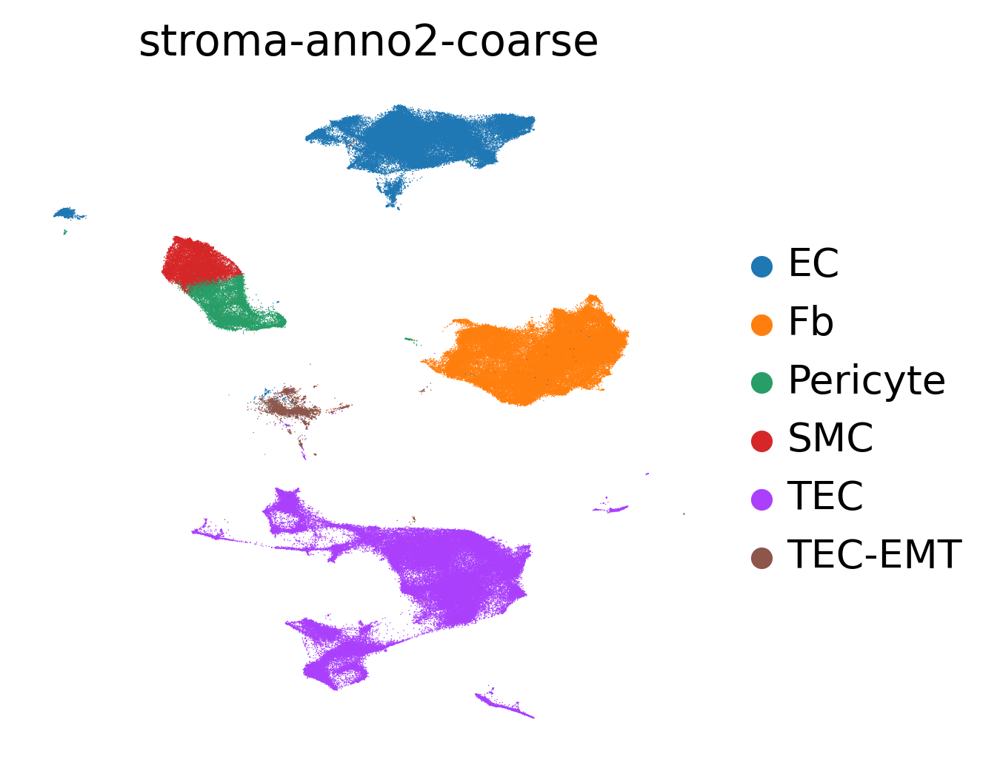

In [120]:
sc.pl.umap(adata[adata.obs['doublet']!= 'manual_doublet',], color = 'stroma-anno2-coarse', frameon = False)

In [121]:
adata_dbrm2 = adata[adata.obs['doublet']!= 'manual_doublet',].copy()

adata.shape[0]-adata_dbrm2.shape[0]

7555

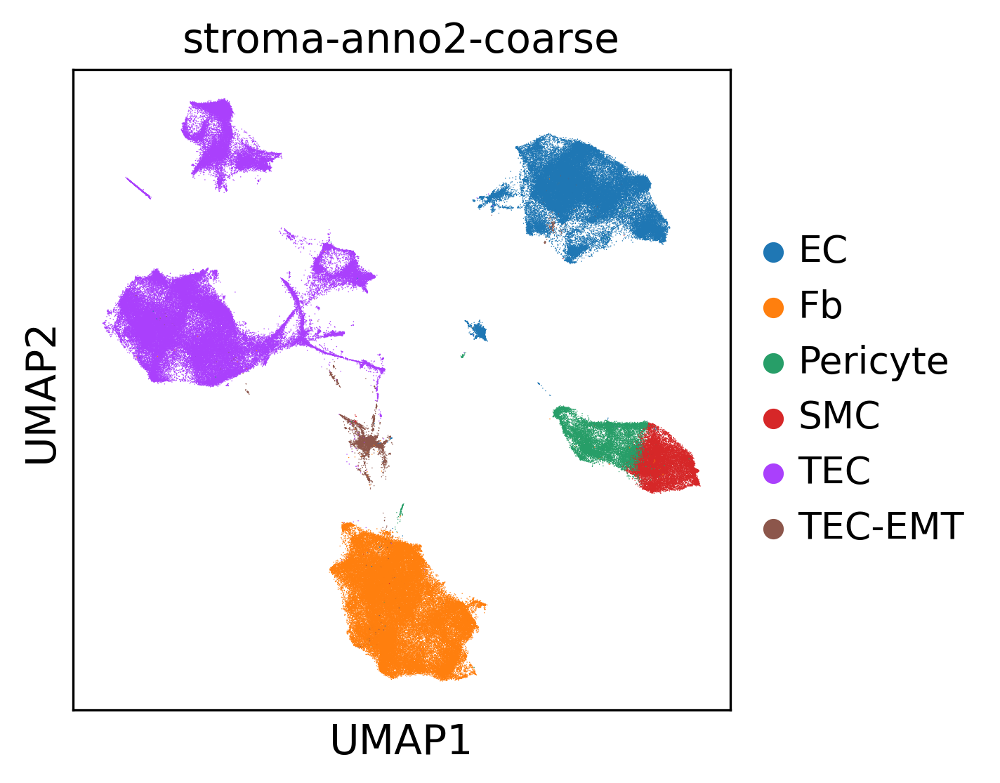

In [122]:
sc.pp.neighbors(adata_dbrm2, use_rep = "X_scVI")
sc.tl.umap(adata_dbrm2, min_dist = 0.1, spread = 1)
sc.pl.umap(adata_dbrm2, color = 'stroma-anno2-coarse')

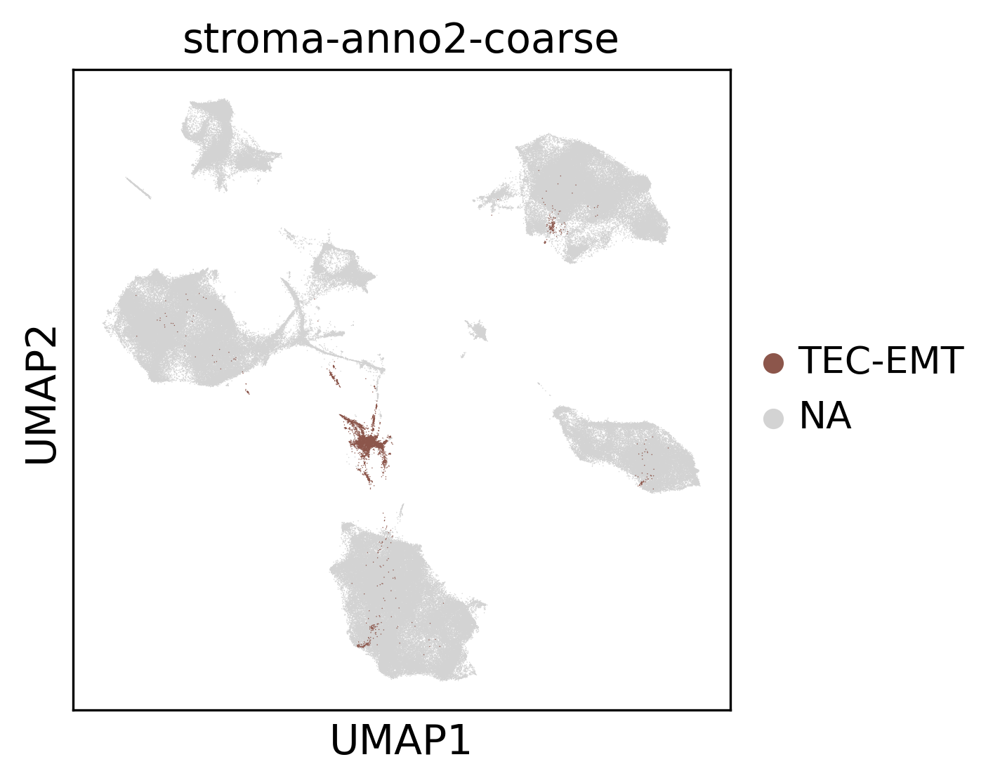

In [126]:
sc.pl.umap(adata_dbrm2, color = 'stroma-anno2-coarse', groups = ['TEC-EMT'])

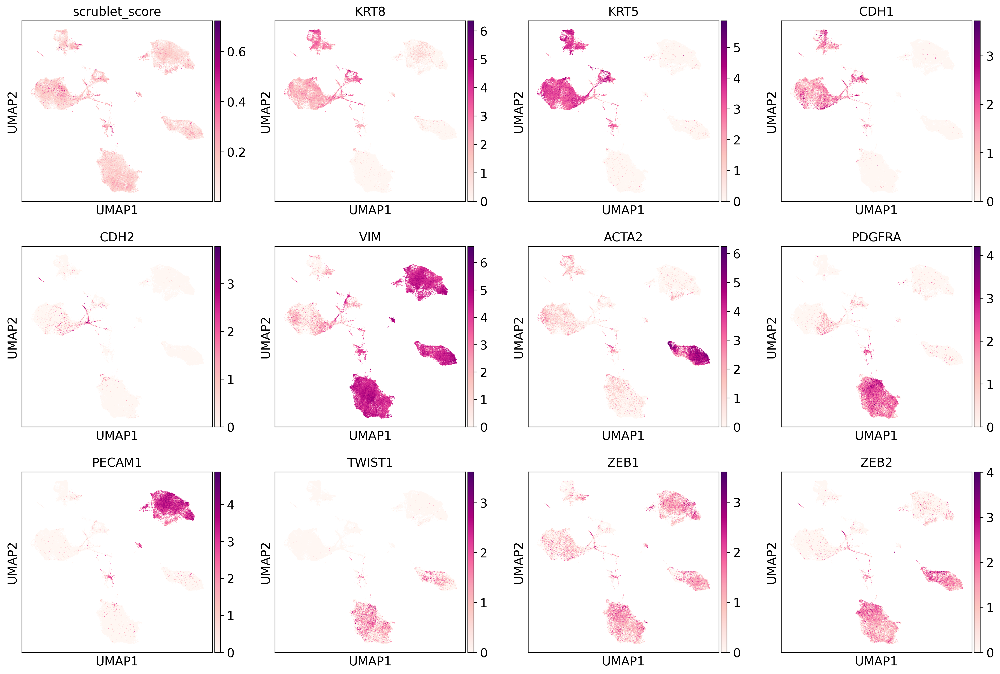

In [130]:
sc.pl.umap(adata_dbrm2, color = ['scrublet_score', 'KRT8', 'KRT5', 'CDH1', 'CDH2', 'VIM', 'ACTA2','PDGFRA', 
                                 'PECAM1', 
                                'TWIST1', 'ZEB1', 'ZEB2'])